<b>Data mining Project - 2021/22</b><br/>
<span>
<b>Authors:</b> Mariagiovanna Rotundo (560765), Nunzio Lopardo (600005)</a> and Renato Eschini (203021)<br/>
<b>Group:</b>3<br/>
<b>Release date:</b> 26/12/2021
</span>

# Time series analysis

**Import of libraries**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tslearn.clustering import TimeSeriesKMeans
import os
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
import scipy.cluster.hierarchy as hr
from scipy.cluster.hierarchy import fcluster

**loading of the dataset**

In [2]:
# load of the data
DATASET_DIR =  '..' + os.path.sep + "dataset" + os.path.sep
#index_col=False say to not use the first column as ID
df_temperatures = pd.read_csv(DATASET_DIR +'CityGlobalTemperature2000-2009.csv', sep=',', index_col=0) 

**print dataset and information**

In [3]:
df_temperatures.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12000 entries, 1813 to 239132
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   AverageTemperature             12000 non-null  float64
 1   AverageTemperatureUncertainty  12000 non-null  float64
 2   City                           12000 non-null  object 
 3   Country                        12000 non-null  object 
 4   Latitude                       12000 non-null  object 
 5   Longitude                      12000 non-null  object 
 6   time                           12000 non-null  object 
dtypes: float64(2), object(5)
memory usage: 750.0+ KB


In [4]:
df_temperatures

,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude,time
1813,27.685,0.267,Abidjan,Côte D'Ivoire,5.63N,3.23W,2000-02-01
1814,29.061,0.224,Abidjan,Côte D'Ivoire,5.63N,3.23W,2000-03-01
1815,28.162,0.478,Abidjan,Côte D'Ivoire,5.63N,3.23W,2000-04-01
1816,27.547,0.509,Abidjan,Côte D'Ivoire,5.63N,3.23W,2000-05-01
1817,25.812,0.231,Abidjan,Côte D'Ivoire,5.63N,3.23W,2000-06-01
...,...,...,...,...,...,...,...
239128,18.459,0.374,Xian,China,34.56N,108.97E,2009-09-01
239129,14.195,0.163,Xian,China,34.56N,108.97E,2009-10-01
239130,2.916,0.675,Xian,China,34.56N,108.97E,2009-11-01
239131,-0.712,0.259,Xian,China,34.56N,108.97E,2009-12-01


**Creation of time series for cities**

The rows are sorted by the time when the data are collectioned (the column time). Then, a time series for each city is created considering the column of the average temperature because to analize the trend of themperature the information we need are the value in this column.

In [5]:
df_temperatures.sort_values(['time'], inplace = True)

In [6]:
ts = df_temperatures.groupby(['City'])['AverageTemperature'].apply(list)

In [7]:
ts.index

Index(['Abidjan', 'Addis Abeba', 'Ahmadabad', 'Aleppo', 'Alexandria', 'Ankara',
       'Baghdad', 'Bangalore', 'Bangkok', 'Belo Horizonte', 'Berlin', 'Bogotá',
       'Bombay', 'Brasília', 'Cairo', 'Calcutta', 'Cali', 'Cape Town',
       'Casablanca', 'Changchun', 'Chengdu', 'Chicago', 'Chongqing', 'Dakar',
       'Dalian', 'Dar Es Salaam', 'Delhi', 'Dhaka', 'Durban', 'Faisalabad',
       'Fortaleza', 'Gizeh', 'Guangzhou', 'Harare', 'Harbin',
       'Ho Chi Minh City', 'Hyderabad', 'Ibadan', 'Istanbul', 'Izmir',
       'Jaipur', 'Jakarta', 'Jiddah', 'Jinan', 'Kabul', 'Kano', 'Kanpur',
       'Karachi', 'Kiev', 'Kinshasa', 'Lagos', 'Lahore', 'Lakhnau', 'Lima',
       'London', 'Los Angeles', 'Luanda', 'Madras', 'Madrid', 'Manila',
       'Mashhad', 'Melbourne', 'Mexico', 'Mogadishu', 'Montreal', 'Moscow',
       'Nagoya', 'Nagpur', 'Nairobi', 'Nanjing', 'New Delhi', 'New York',
       'Paris', 'Peking', 'Pune', 'Rangoon', 'Rio De Janeiro', 'Riyadh',
       'Rome', 'Saint Petersburg', 'S

In [8]:
#check that all lengths are equal
for i in range(len(ts)):
    if len(ts[i])!=len(ts[0]):
        print(len(ts[i]))

In [9]:
time_series = []

for i in range(len(ts)):
    time_series.append(pd.Series(ts[i]))

In [10]:
time_series_mean = np.array(time_series)

In [11]:
time_series_mean.shape

(100, 120)

**plot of time series associated to cities**

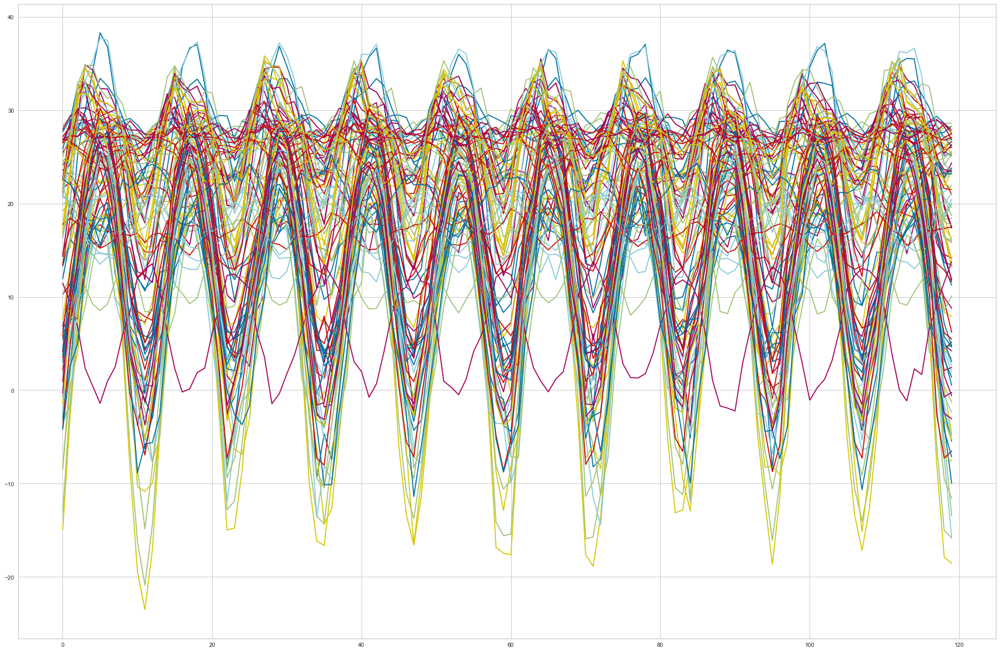

In [12]:
plt.figure(figsize = (30,20))
for i in range(time_series_mean.shape[0]):
    plt.plot(time_series_mean[i])
plt.show()

## Clustering

For the clustering we try 2 algorithms, the Kmeans and the hierarchical algorithm.

**KMeans**: for the Kmeans we use 2 kind of distances: the euclidean and the dtw. For use the euclidean distance we correct the distorsions of offset translation, amplitude scaling. For find the best the number of clusters we use the elbow method.

**Hierarchical clustering**: for the hierarchical clustering we use the euclidean distance and, for the distances between "partial" clusters we use an average method. For the number of cluster we choose the value that gives us the best clusters.

**correction of distorsions to use euclidean distance**

In [13]:
time_series_mean_euclidean = time_series_mean.copy()
for i in range(time_series_mean.shape[0]):
    time_series_mean_euclidean[i] = (time_series_mean[i] - time_series_mean[i].mean())/time_series_mean[i].std()

## Kmeans

### Euclidean distance

**application of the elbow method**

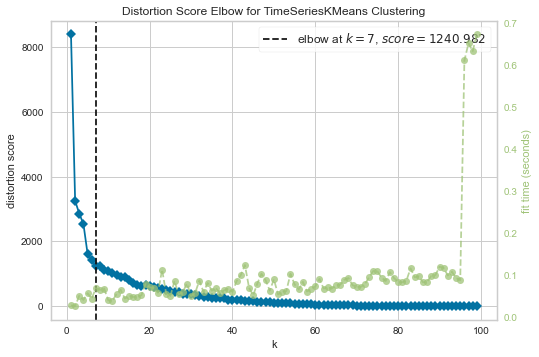

<AxesSubplot:title={'center':'Distortion Score Elbow for TimeSeriesKMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [14]:
visualizer = KElbowVisualizer(TimeSeriesKMeans(), k=(1,100))

visualizer.fit(time_series_mean_euclidean)        # Fit the data to the visualizer
visualizer.show()  

In [15]:
km = TimeSeriesKMeans(n_clusters=7, metric="euclidean", max_iter=10, random_state=0)
km.fit(time_series_mean_euclidean)

TimeSeriesKMeans(max_iter=10, n_clusters=7, random_state=0)

In [16]:
km.labels_

array([1, 1, 4, 0, 0, 0, 0, 3, 3, 5, 0, 6, 4, 2, 0, 4, 6, 5, 0, 0, 0, 0,
       0, 0, 0, 5, 4, 4, 5, 0, 2, 0, 0, 2, 0, 4, 3, 1, 0, 0, 4, 3, 0, 0,
       0, 3, 4, 4, 0, 1, 1, 0, 4, 5, 0, 0, 1, 4, 0, 3, 0, 5, 4, 1, 0, 0,
       0, 4, 1, 0, 4, 0, 0, 0, 3, 3, 1, 0, 0, 0, 5, 5, 0, 0, 0, 0, 4, 2,
       4, 5, 5, 0, 0, 0, 0, 0, 0, 4, 0, 0], dtype=int64)

**print information about clusters**

In [17]:
unique, counts = np.unique(km.labels_, return_counts=True)

In [18]:
print(counts)

[50  9  4  8 17 10  2]


**print time series divided by cluster**

In [19]:
plot_array = []
for j in range(len(counts)):
    t_plot=[]
    for i,elem in enumerate(km.labels_):
        if elem == j:
            t_plot.append(time_series_mean[i])

    t_plot = np.array(t_plot)
    plot_array.append(t_plot)

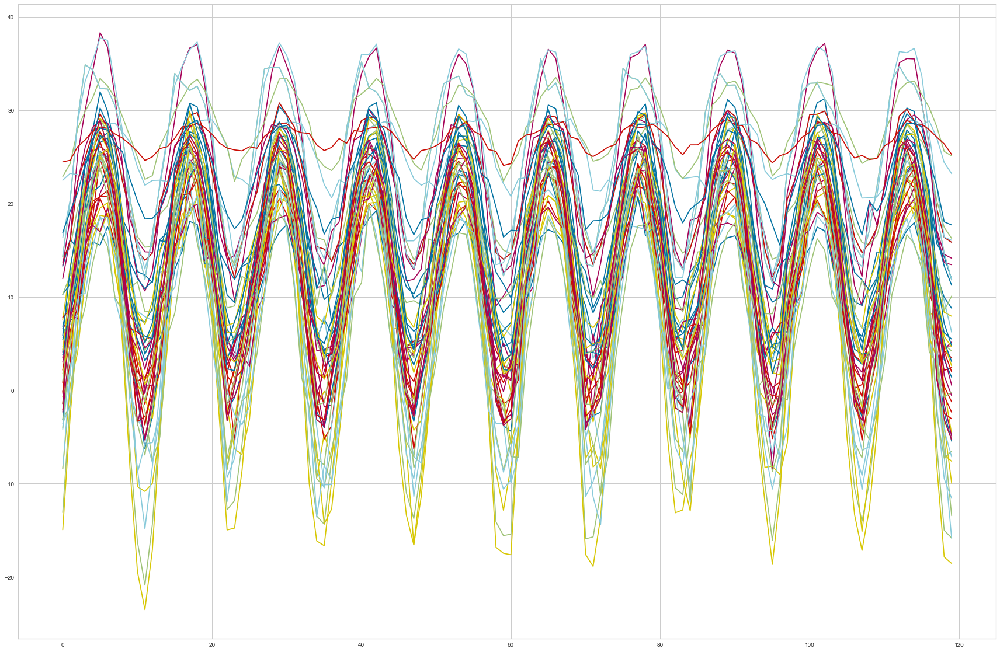

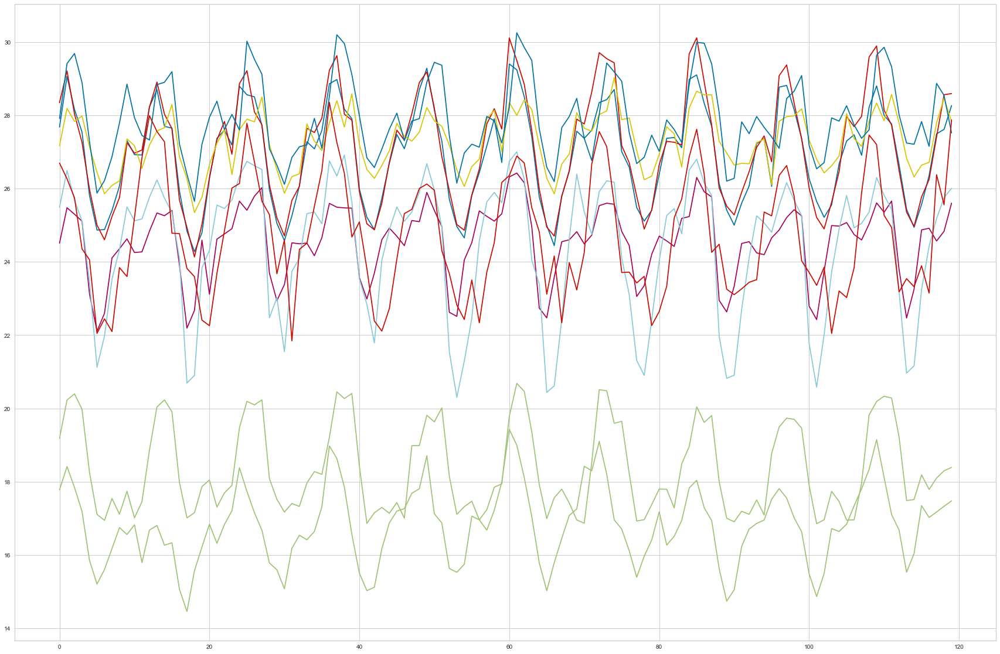

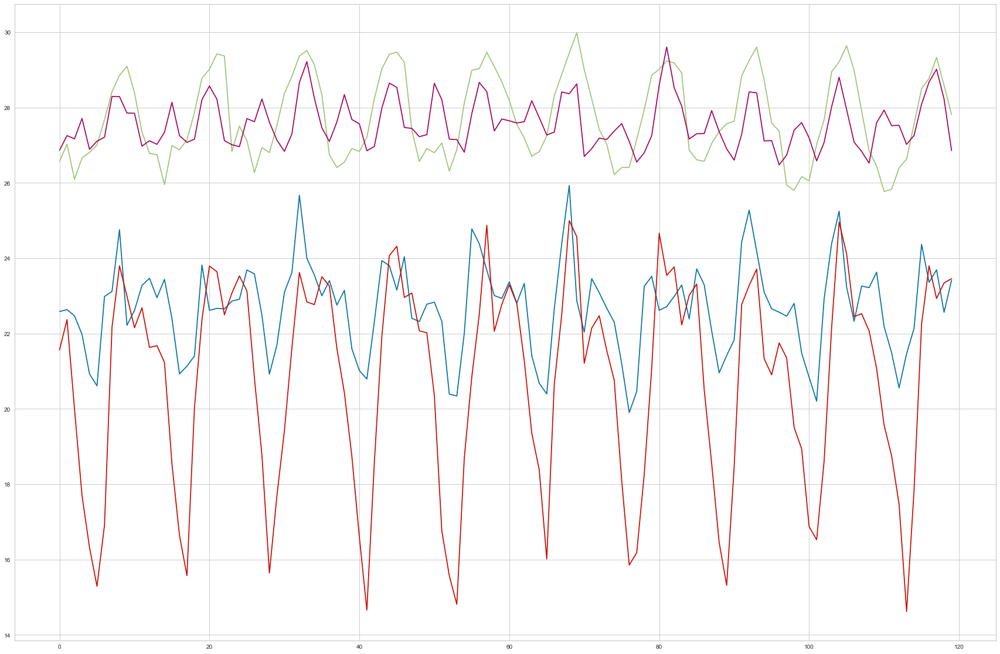

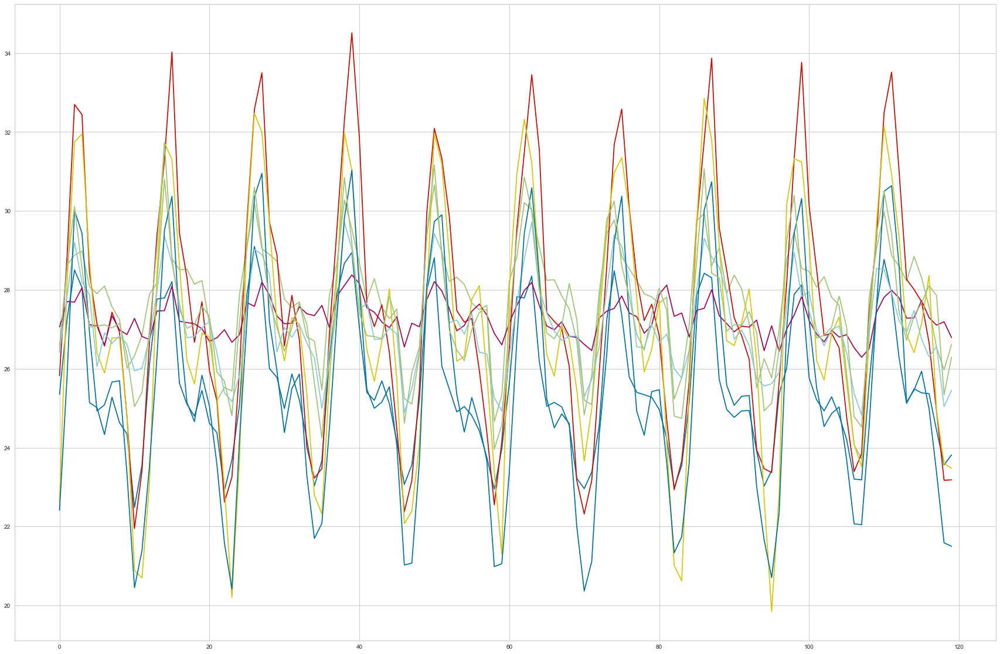

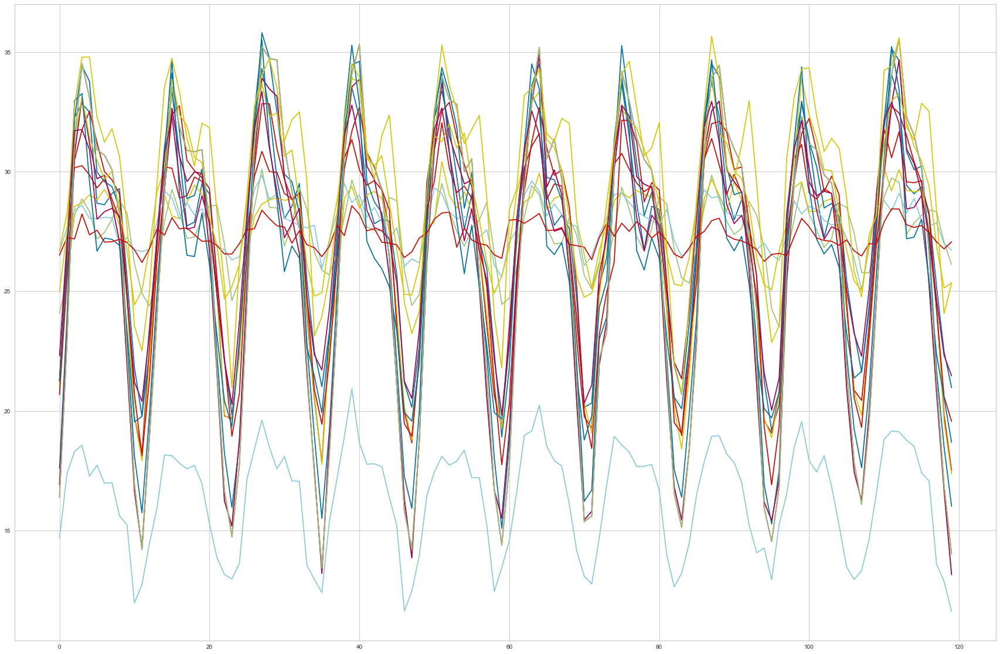

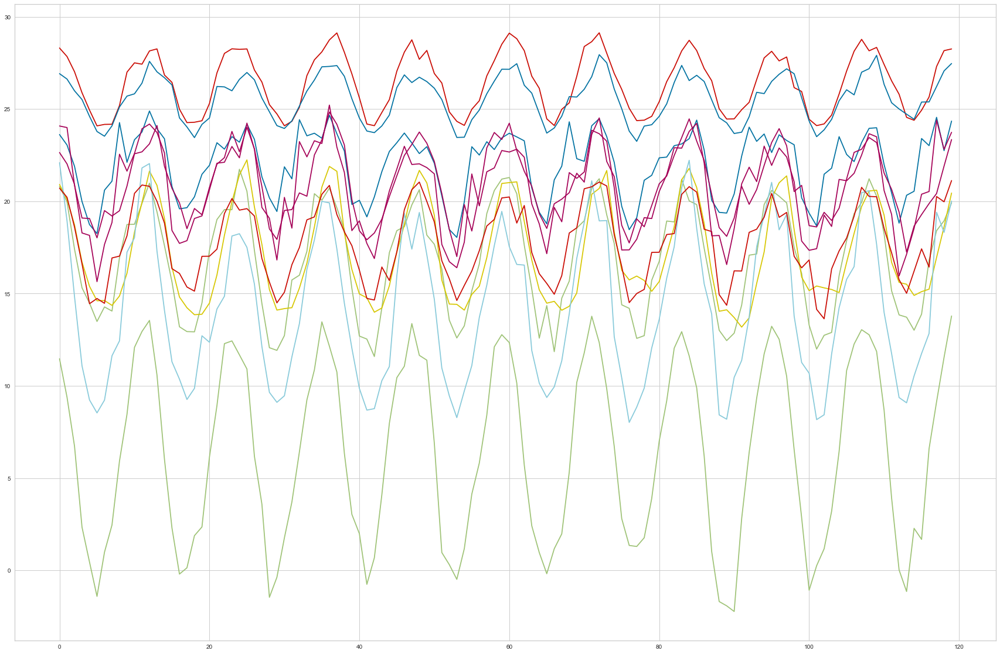

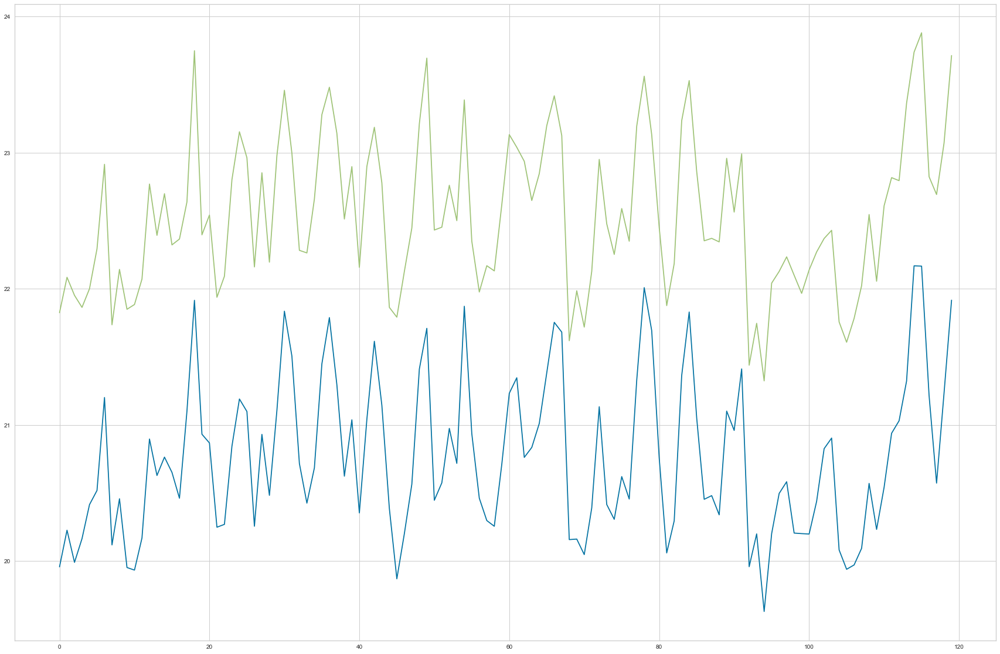

In [20]:
for j in range(len(counts)):
    plt.figure(figsize = (30,20))
    for i in range(plot_array[j].shape[0]):
        plt.plot(plot_array[j][i])
    plt.show()

**print time series with corrected distorsions divided by cluster**

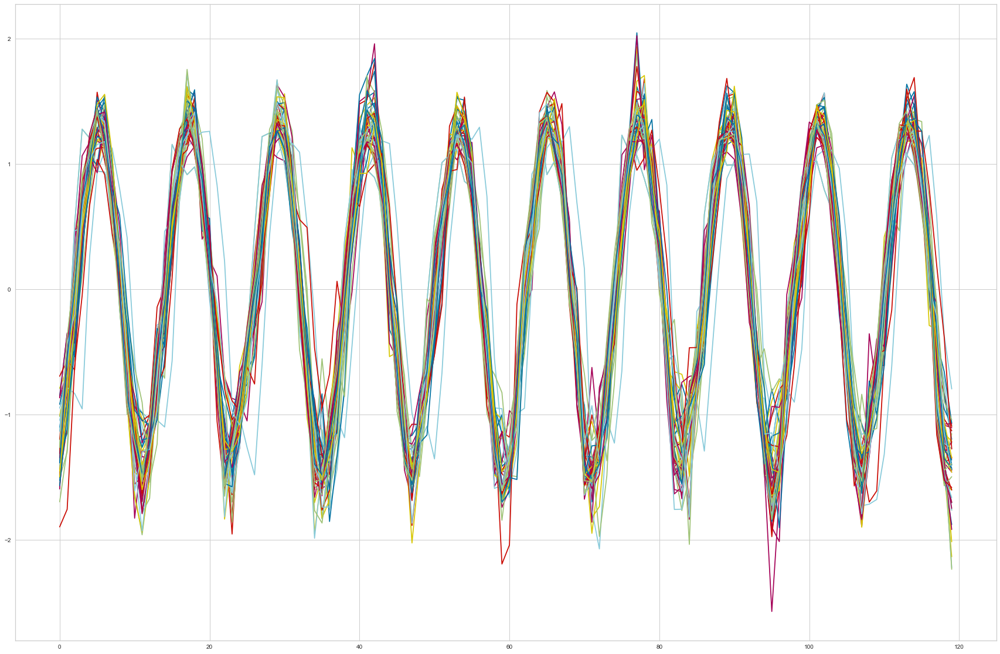

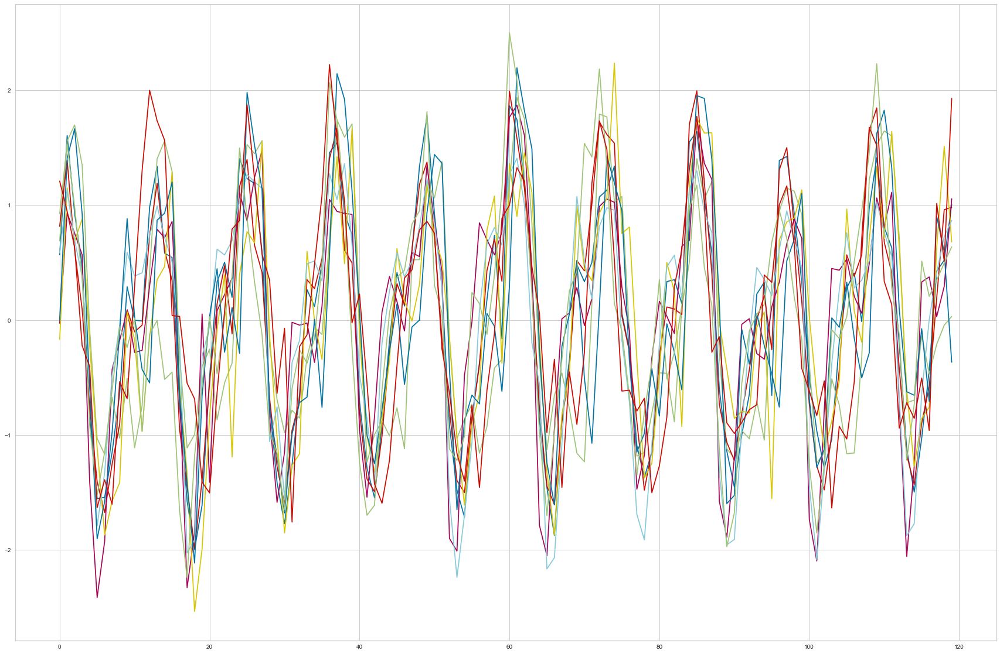

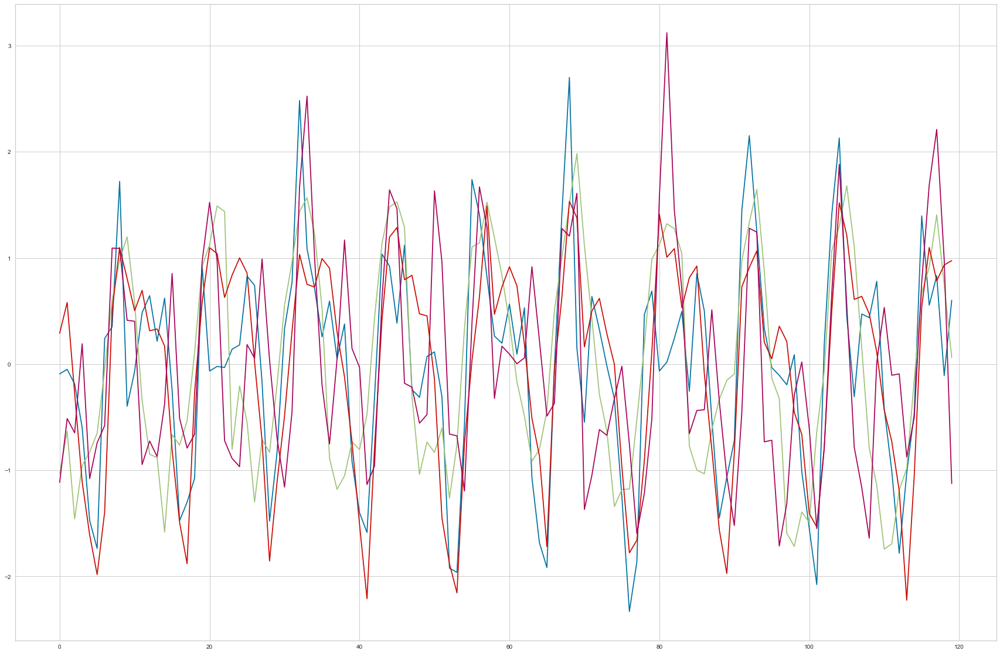

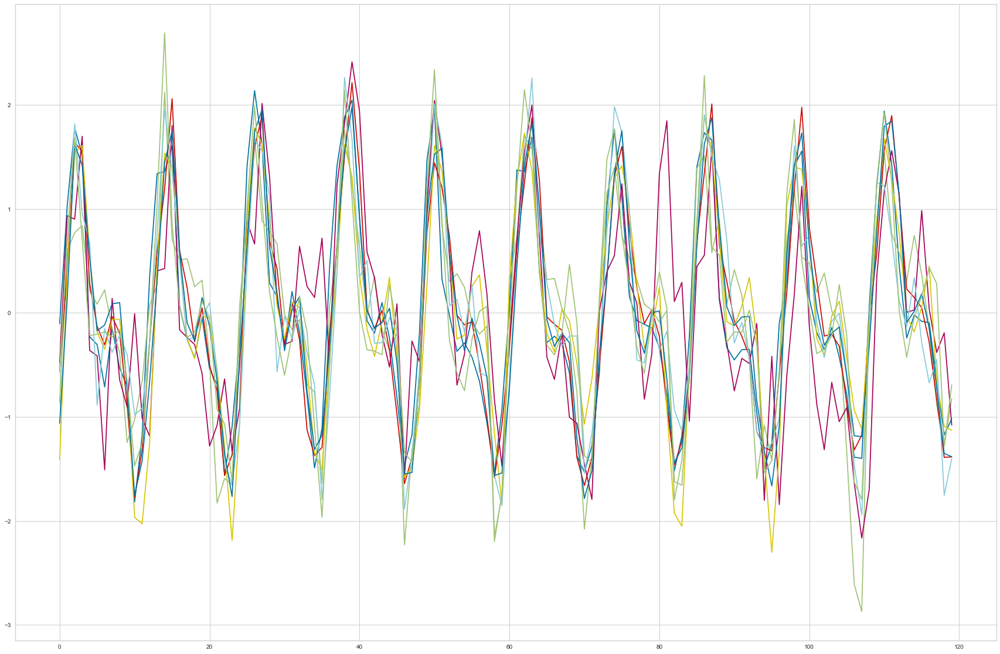

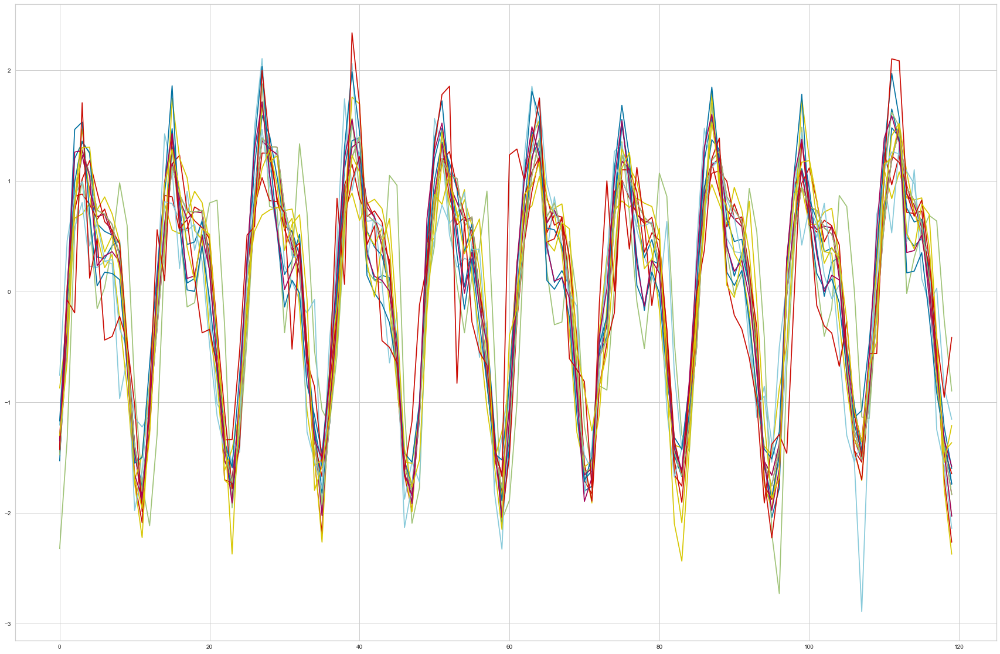

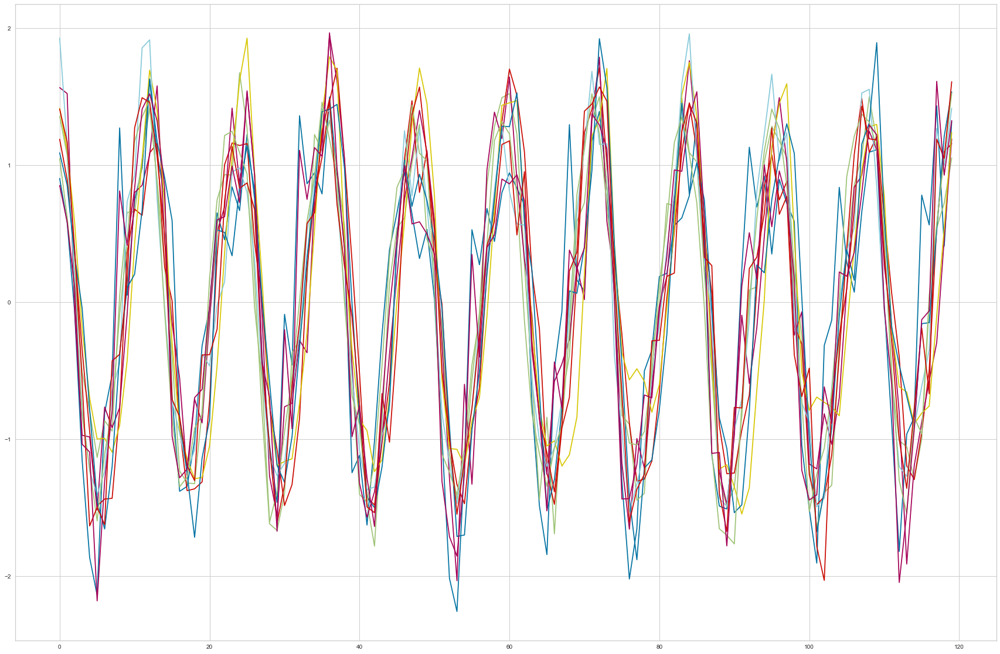

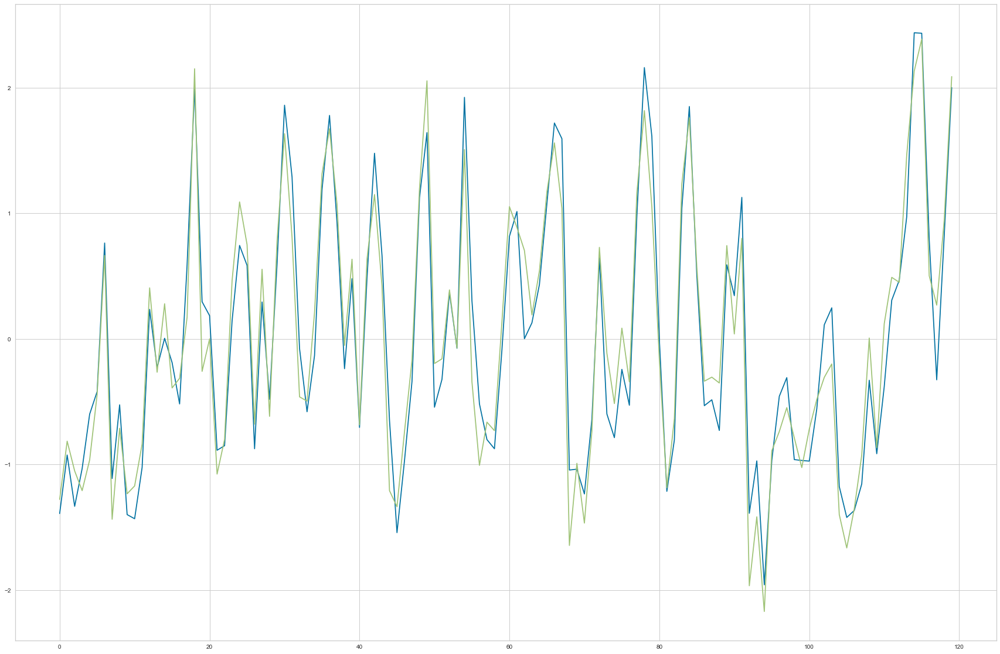

In [21]:
plot_array = []
for j in range(len(counts)):
    t_plot=[]
    for i,elem in enumerate(km.labels_):
        if elem == j:
            t_plot.append(time_series_mean_euclidean[i])

    t_plot = np.array(t_plot)
    plot_array.append(t_plot)
    
for j in range(len(counts)):
    plt.figure(figsize = (30,20))
    for i in range(plot_array[j].shape[0]):
        plt.plot(plot_array[j][i])
    plt.show()

**print of clusters of cities**

In [22]:
cities = []
for j in range(len(counts)):
    city_cluster=[]
    for i,elem in enumerate(km.labels_):
        if elem == j:
            city_cluster.append(ts.index[i])

    city_cluster = np.array(city_cluster)
    cities.append(city_cluster)
    
for j in range(len(counts)):
    print("Cluster ", j, " : ",end=" ")
    print(cities[j],end="\n\n")

Cluster  0  :  ['Aleppo' 'Alexandria' 'Ankara' 'Baghdad' 'Berlin' 'Cairo' 'Casablanca'
 'Changchun' 'Chengdu' 'Chicago' 'Chongqing' 'Dakar' 'Dalian' 'Faisalabad'
 'Gizeh' 'Guangzhou' 'Harbin' 'Istanbul' 'Izmir' 'Jiddah' 'Jinan' 'Kabul'
 'Kiev' 'Lahore' 'London' 'Los Angeles' 'Madrid' 'Mashhad' 'Montreal'
 'Moscow' 'Nagoya' 'Nanjing' 'New York' 'Paris' 'Peking' 'Riyadh' 'Rome'
 'Saint Petersburg' 'Santo Domingo' 'Seoul' 'Shanghai' 'Shenyang' 'Taipei'
 'Taiyuan' 'Tangshan' 'Tianjin' 'Tokyo' 'Toronto' 'Wuhan' 'Xian']

Cluster  1  :  ['Abidjan' 'Addis Abeba' 'Ibadan' 'Kinshasa' 'Lagos' 'Luanda' 'Mogadishu'
 'Nairobi' 'Rio De Janeiro']

Cluster  2  :  ['Brasília' 'Fortaleza' 'Harare' 'Surabaya']

Cluster  3  :  ['Bangalore' 'Bangkok' 'Hyderabad' 'Jakarta' 'Kano' 'Manila' 'Pune'
 'Rangoon']

Cluster  4  :  ['Ahmadabad' 'Bombay' 'Calcutta' 'Delhi' 'Dhaka' 'Ho Chi Minh City'
 'Jaipur' 'Kanpur' 'Karachi' 'Lakhnau' 'Madras' 'Mexico' 'Nagpur'
 'New Delhi' 'Singapore' 'Surat' 'Umm Durman']

Cluste

### Dynamic Time Warping

**application of the elbow method**

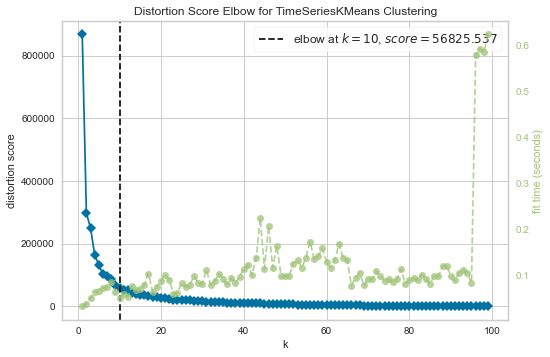

<AxesSubplot:title={'center':'Distortion Score Elbow for TimeSeriesKMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [23]:
visualizer = KElbowVisualizer(TimeSeriesKMeans(), k=(1,100))

visualizer.fit(time_series_mean)        # Fit the data to the visualizer
visualizer.show() 

**clustering**

In [24]:
km_dtw = TimeSeriesKMeans(n_clusters=10, metric="dtw", max_iter=10, random_state=0)
km_dtw.fit(time_series_mean)

TimeSeriesKMeans(max_iter=10, metric='dtw', n_clusters=10, random_state=0)

**Print of information about obtained clusters**

In [25]:
unique, counts = np.unique(km_dtw.labels_, return_counts=True)

In [26]:
print(counts)

[10 10  8  9 12  7  7 17  9 11]


**Print of time series divided by cluster**

In [27]:
plot_array = []
for j in range(len(counts)):
    t_plot=[]
    for i,elem in enumerate(km_dtw.labels_):
        if elem == j:
            t_plot.append(time_series_mean[i])

    t_plot = np.array(t_plot)
    plot_array.append(t_plot)

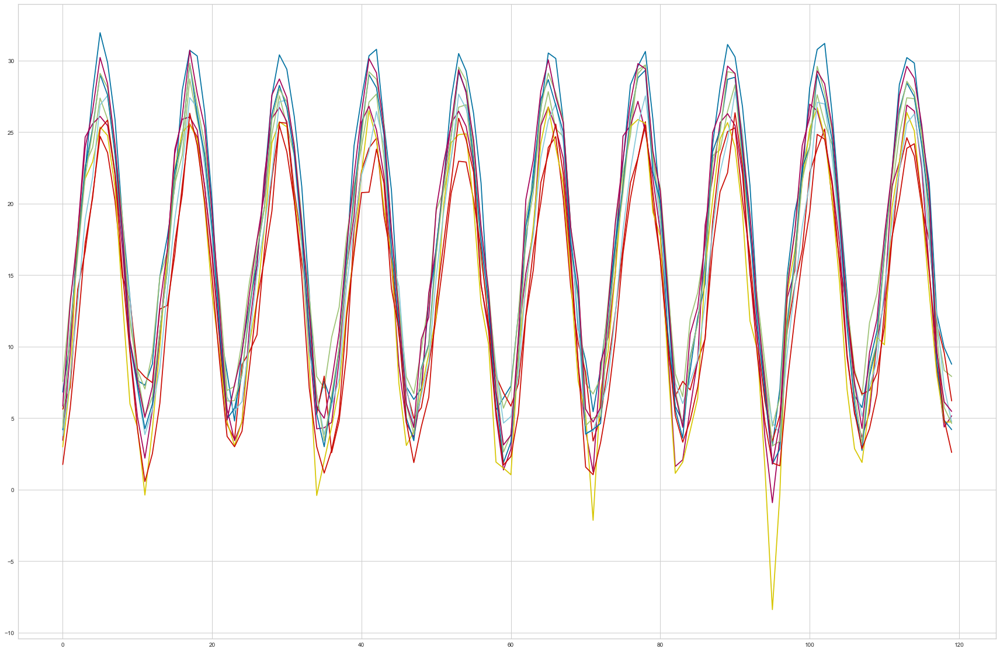

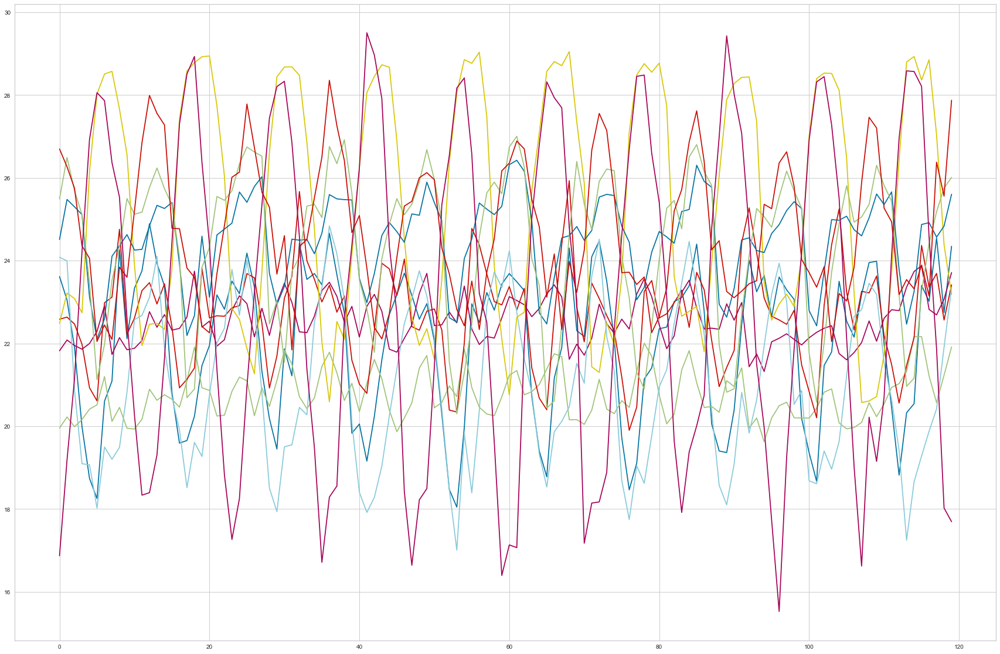

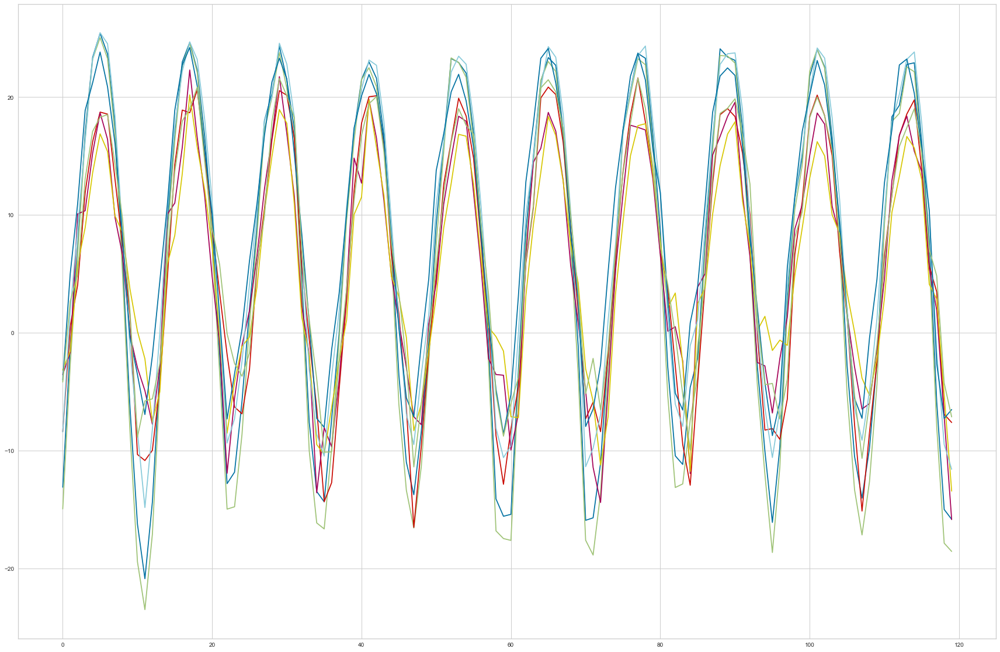

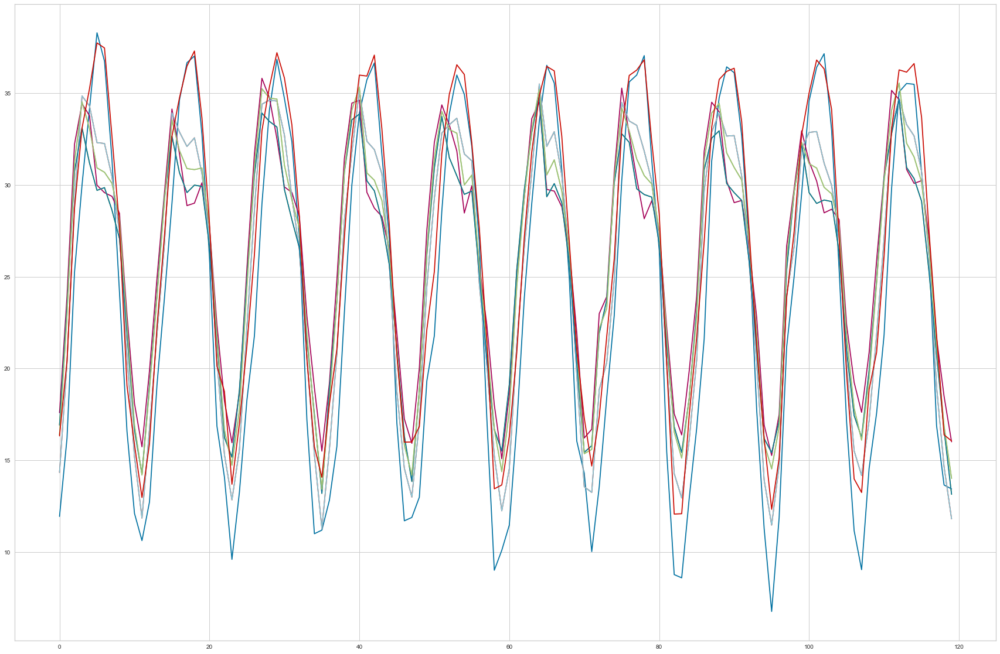

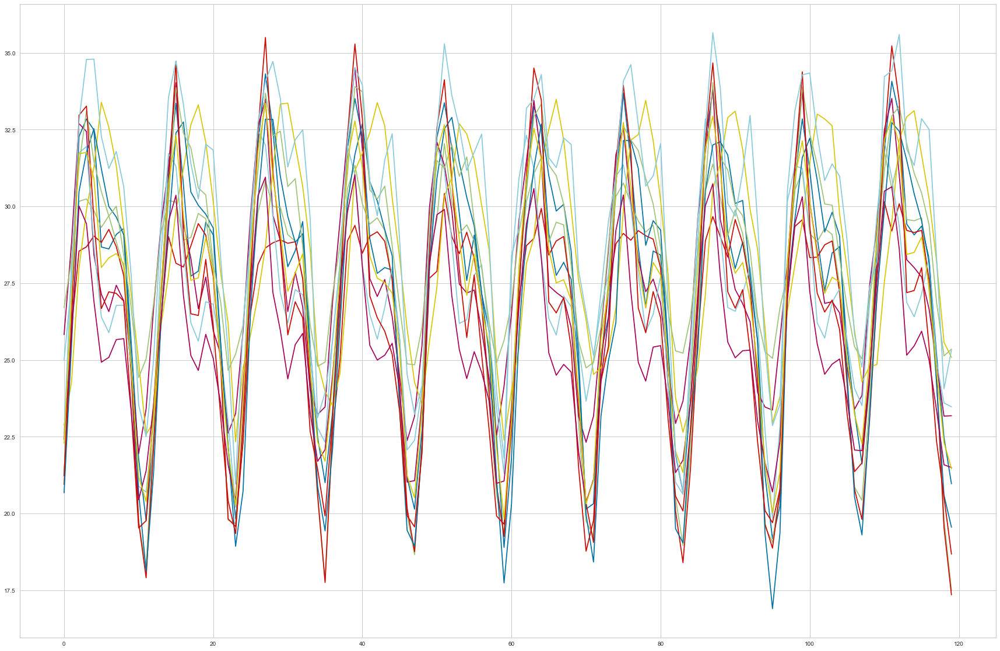

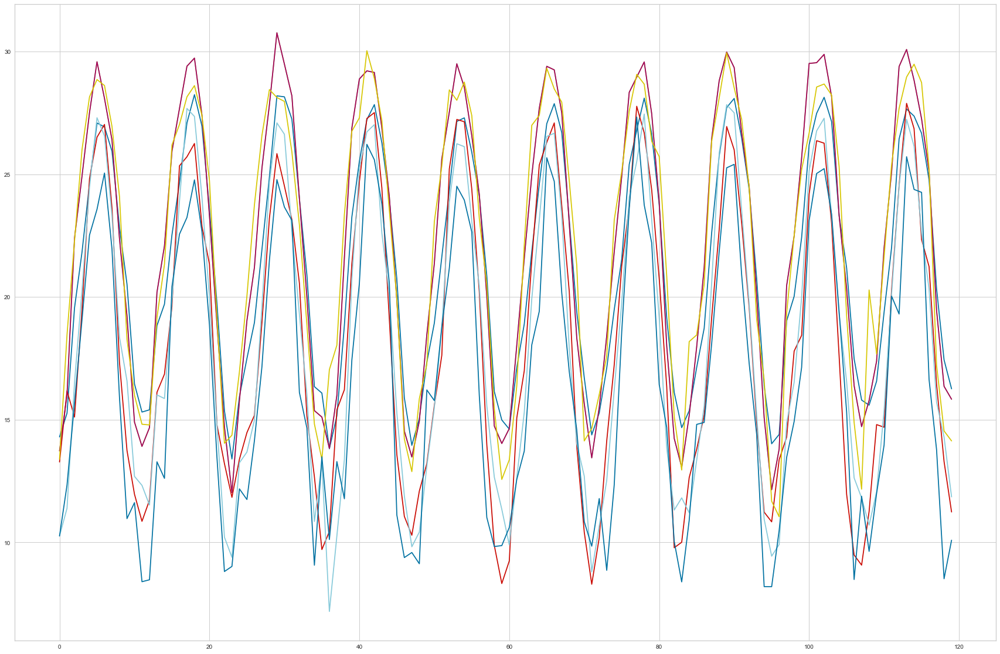

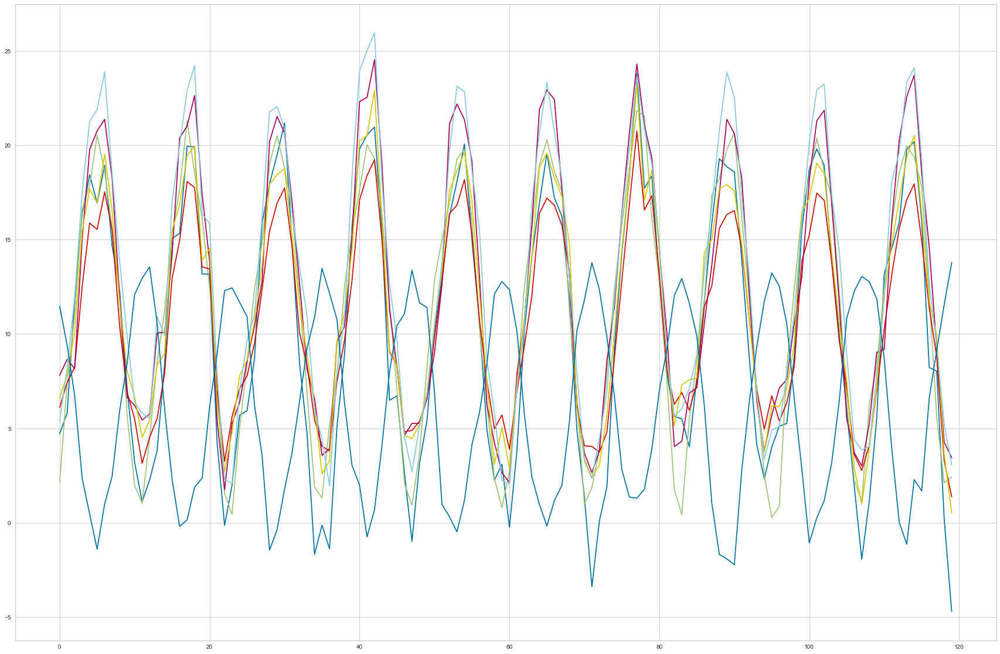

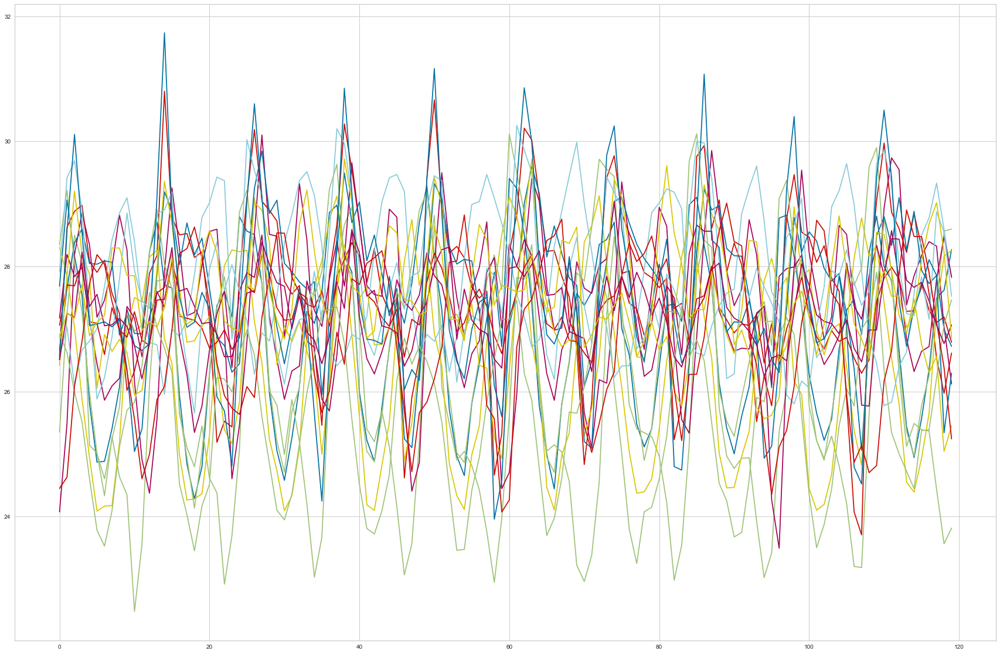

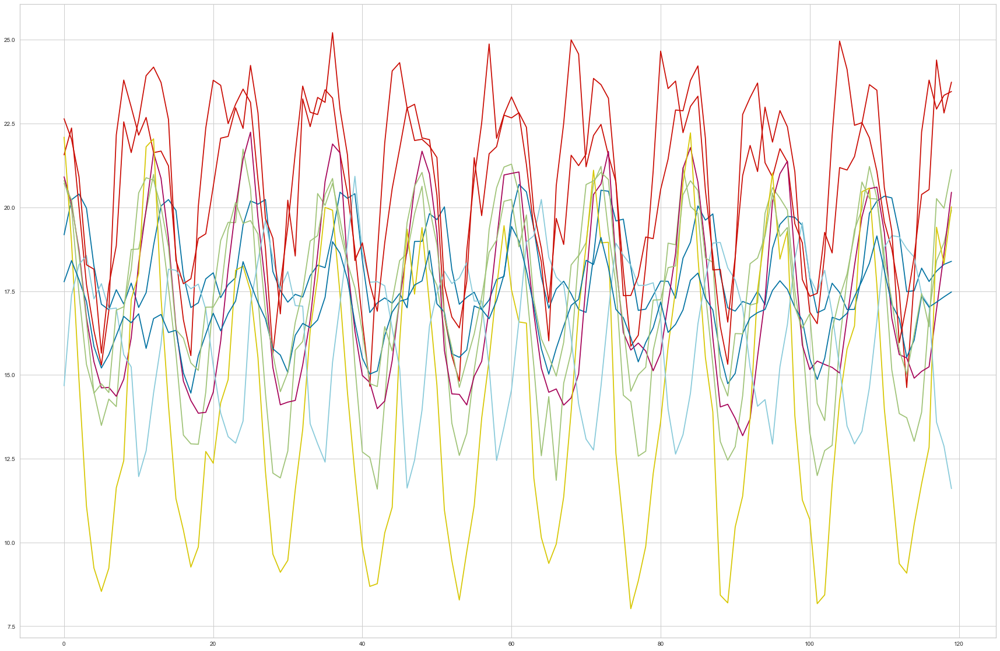

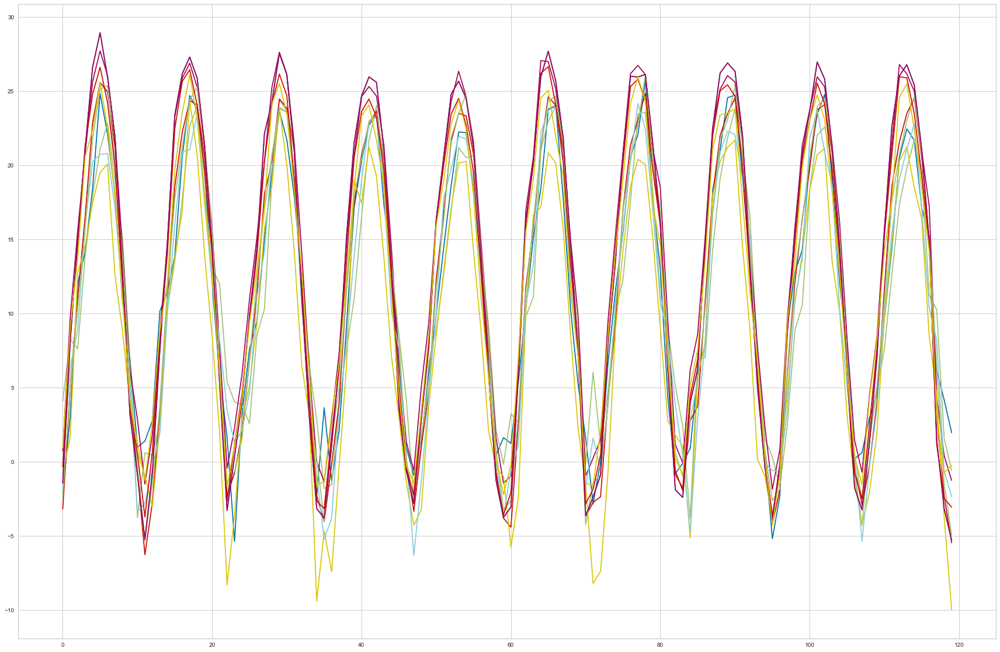

In [28]:
for j in range(len(counts)):
    plt.figure(figsize = (30,20))
    for i in range(plot_array[j].shape[0]):
        plt.plot(plot_array[j][i])
    plt.show()

**print of clusters of cities** 

In [29]:
cities = []
for j in range(len(counts)):
    city_cluster=[]
    for i,elem in enumerate(km_dtw.labels_):
        if elem == j:
            city_cluster.append(ts.index[i])

    city_cluster = np.array(city_cluster)
    cities.append(city_cluster)
    
for j in range(len(counts)):
    print("Cluster ", j, " : ",end=" ")
    print(cities[j],end="\n\n")

Cluster  0  :  ['Aleppo' 'Chongqing' 'Istanbul' 'Kabul' 'Mashhad' 'Nagoya' 'Nanjing'
 'Shanghai' 'Tokyo' 'Wuhan']

Cluster  1  :  ['Belo Horizonte' 'Bogotá' 'Brasília' 'Cali' 'Dakar' 'Durban' 'Kinshasa'
 'Luanda' 'Rio De Janeiro' 'Taipei']

Cluster  2  :  ['Changchun' 'Harbin' 'Montreal' 'Moscow' 'Saint Petersburg' 'Shenyang'
 'Taiyuan' 'Toronto']

Cluster  3  :  ['Baghdad' 'Delhi' 'Faisalabad' 'Jaipur' 'Kanpur' 'Lahore' 'Lakhnau'
 'New Delhi' 'Riyadh']

Cluster  4  :  ['Ahmadabad' 'Calcutta' 'Dhaka' 'Hyderabad' 'Jiddah' 'Kano' 'Karachi'
 'Madras' 'Nagpur' 'Pune' 'Surat' 'Umm Durman']

Cluster  5  :  ['Alexandria' 'Cairo' 'Casablanca' 'Gizeh' 'Guangzhou' 'Izmir'
 'Los Angeles']

Cluster  6  :  ['Berlin' 'Chengdu' 'London' 'Madrid' 'Paris' 'Rome' 'Santiago']

Cluster  7  :  ['Abidjan' 'Bangalore' 'Bangkok' 'Bombay' 'Dar Es Salaam' 'Fortaleza'
 'Ho Chi Minh City' 'Ibadan' 'Jakarta' 'Lagos' 'Manila' 'Mogadishu'
 'Rangoon' 'Salvador' 'Santo Domingo' 'Singapore' 'Surabaya']

Cluster  8  :  

### Hierarchical clustering

**function to print information about clusters and return labels**

In [30]:
def print_clusters(time_series_mean, Z, k, plot=False):
    # k Number of clusters I'd like to extract
    results = fcluster(Z, k, criterion='maxclust')

    # check the results
    s = pd.Series(results)
    clusters = s.unique()
    
    for c in clusters:
        cluster_indeces = s[s==c].index
        print("Cluster %d number of entries %d" % (c, len(cluster_indeces)))
        if plot:
            timeSeries.T.iloc[:,cluster_indeces].plot()
            plt.show()
            
    return s.to_numpy(dtype=int)

**clustering and print dendogram**

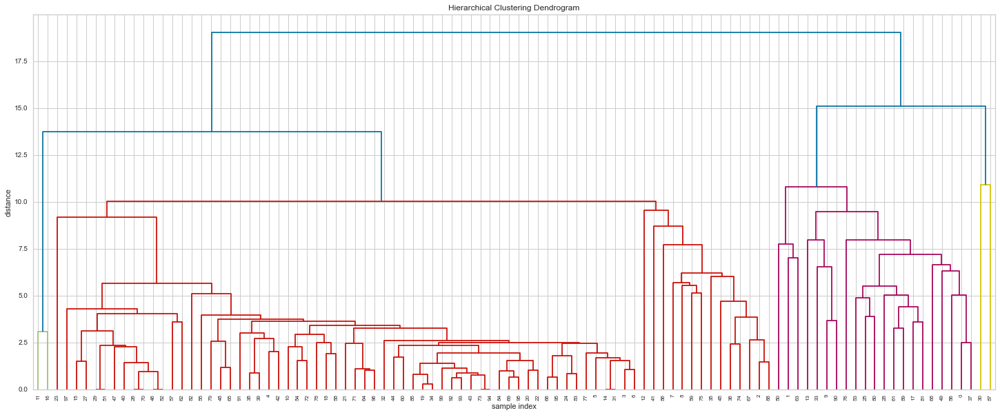

In [31]:
# Do the clustering
Z = hr.linkage(time_series_mean_euclidean, method='average', metric='euclidean')

# Plot dendogram
plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
hr.dendrogram(
    Z,
    leaf_rotation=90.,  # rotates the x axis labels
    leaf_font_size=8.,  # font size for the x axis labels
)
plt.show()

In [32]:
labels = print_clusters(time_series_mean, Z, 11, plot=False)

Cluster 9 number of entries 14
Cluster 7 number of entries 3
Cluster 4 number of entries 12
Cluster 2 number of entries 60
Cluster 8 number of entries 4
Cluster 1 number of entries 2
Cluster 6 number of entries 1
Cluster 3 number of entries 1
Cluster 10 number of entries 1
Cluster 5 number of entries 1
Cluster 11 number of entries 1


In [33]:
labels

array([ 9,  7,  4,  2,  2,  2,  2,  4,  4,  8,  2,  1,  6,  8,  2,  2,  1,
        9,  2,  2,  2,  2,  2,  3,  2,  9,  2,  2,  9,  2, 10,  2,  2,  8,
        2,  4,  4,  9,  2,  2,  2,  5,  2,  2,  2,  4,  2,  2,  2,  9,  7,
        2,  2,  9,  2,  2,  9,  2,  2,  4,  2,  9,  2,  7,  2,  2,  2,  4,
        9,  2,  2,  2,  2,  2,  4,  4,  9,  2,  2,  2,  9,  9,  2,  2,  2,
        2,  4, 11,  4,  9,  8,  2,  2,  2,  2,  2,  2,  2,  2,  2],
      dtype=int32)

In [34]:
unique, counts = np.unique(labels, return_counts=True)

In [35]:
print(counts)

[ 2 60  1 12  1  1  3  4 14  1  1]


**Plot time series divided by clusters**

<Figure size 2160x1440 with 0 Axes>

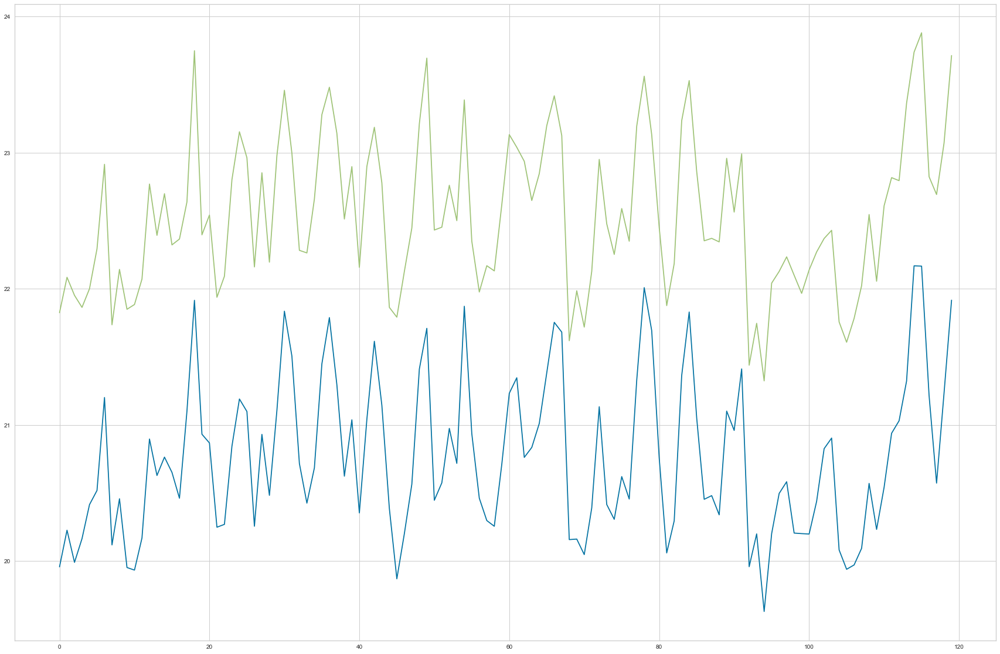

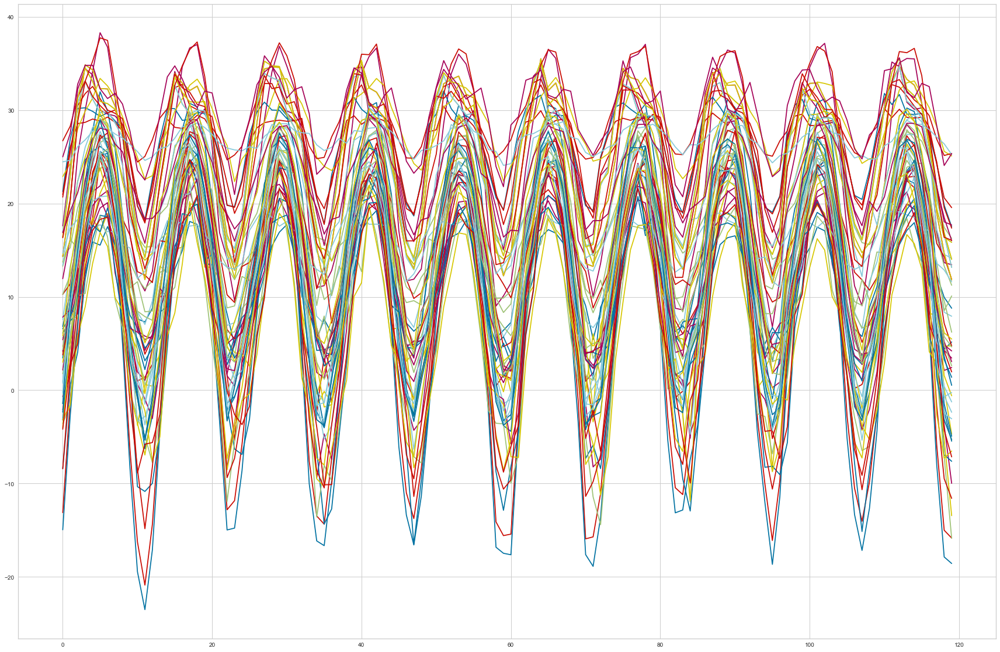

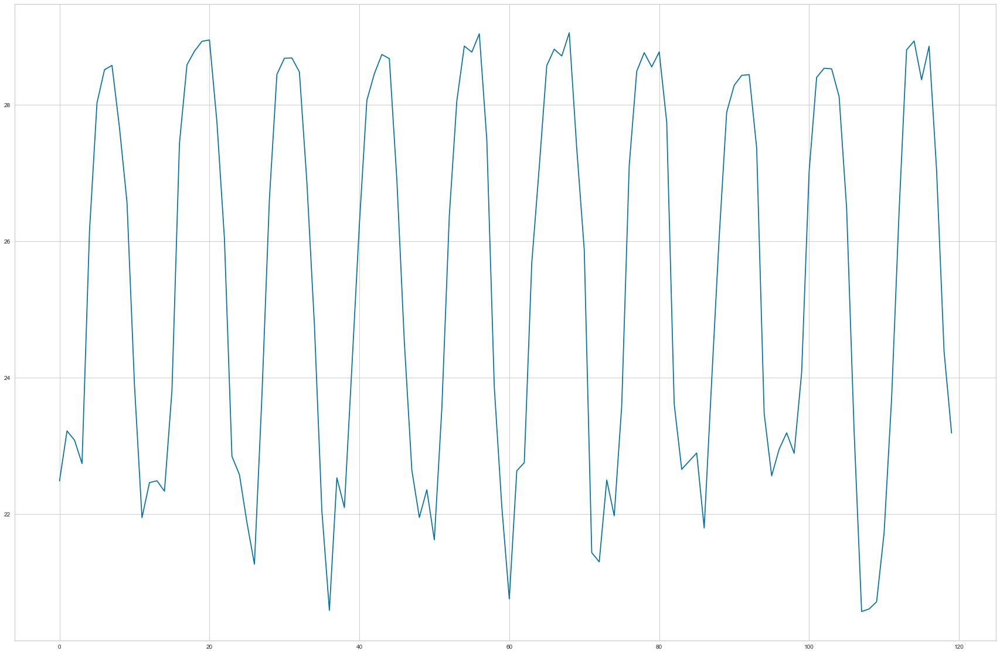

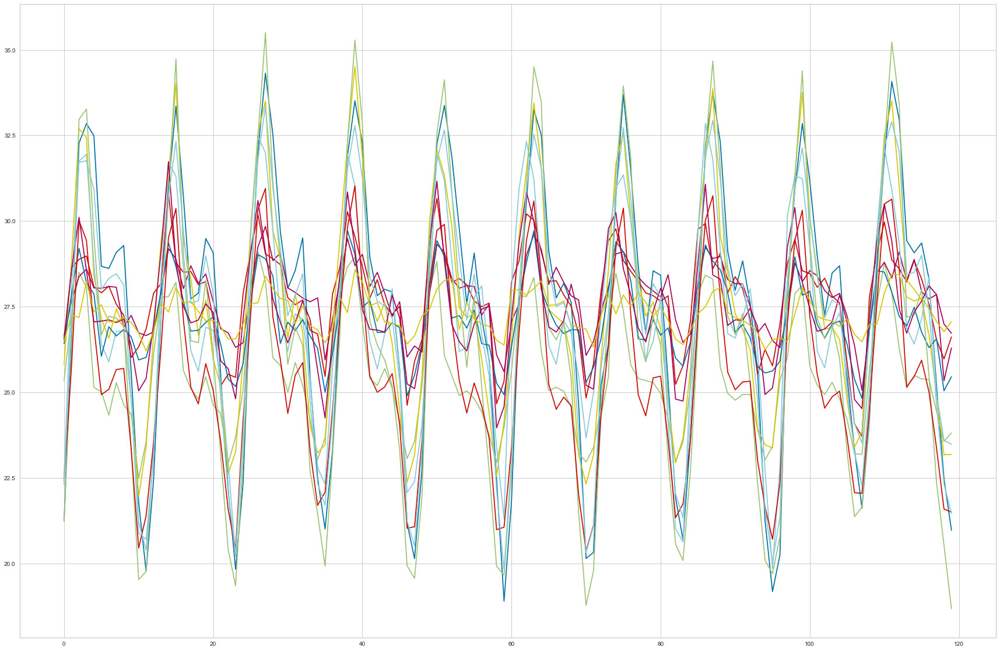

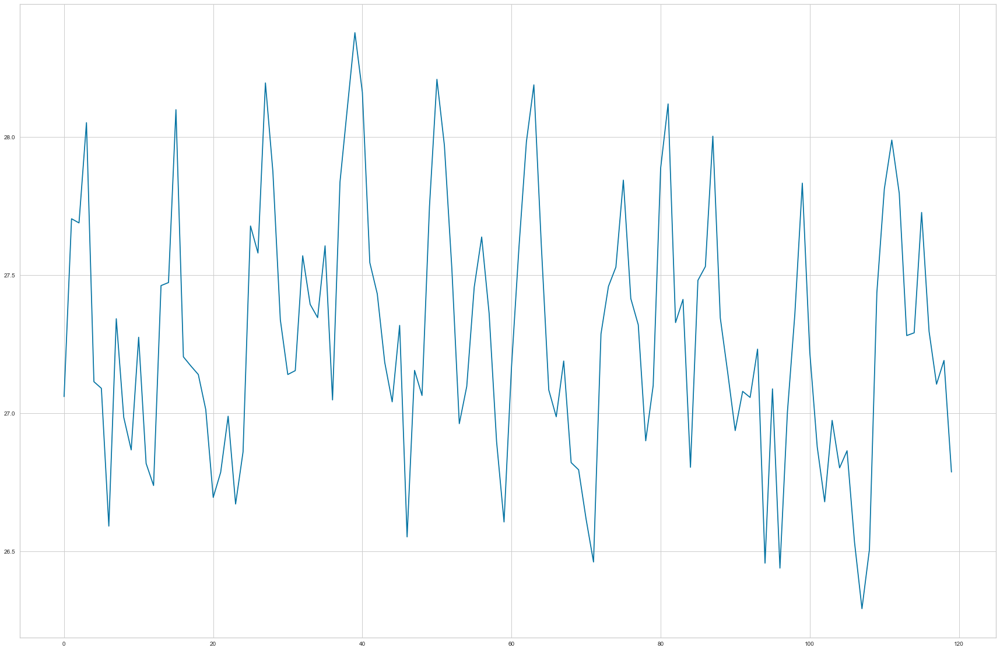

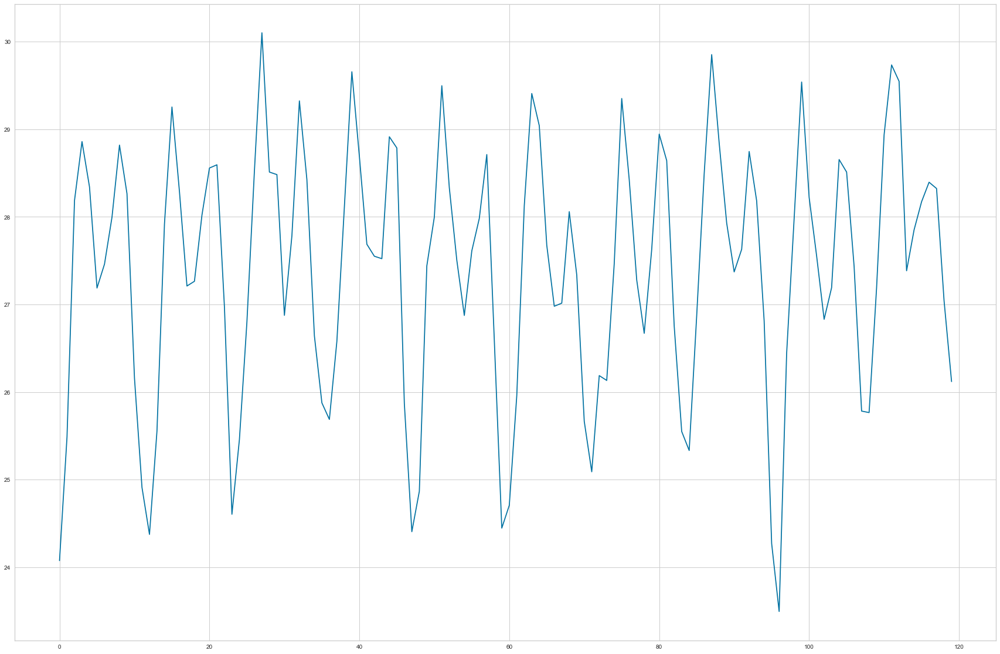

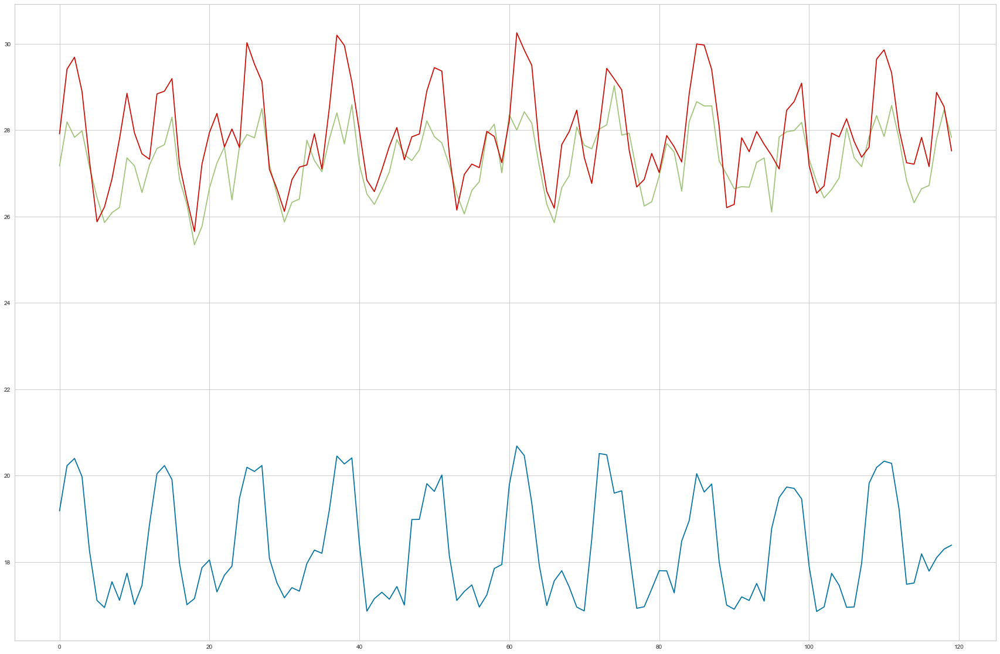

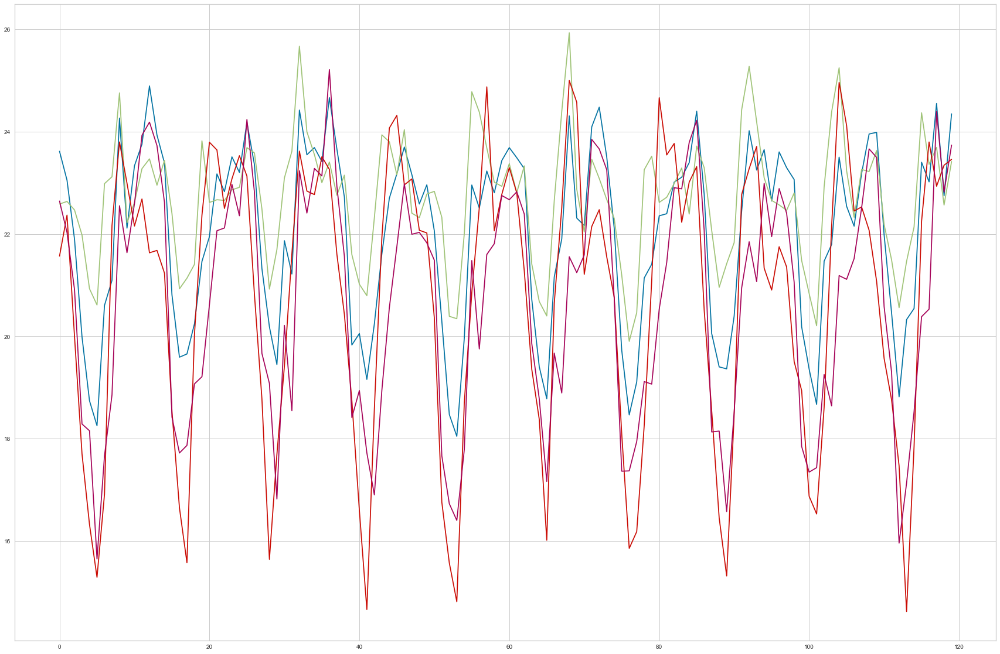

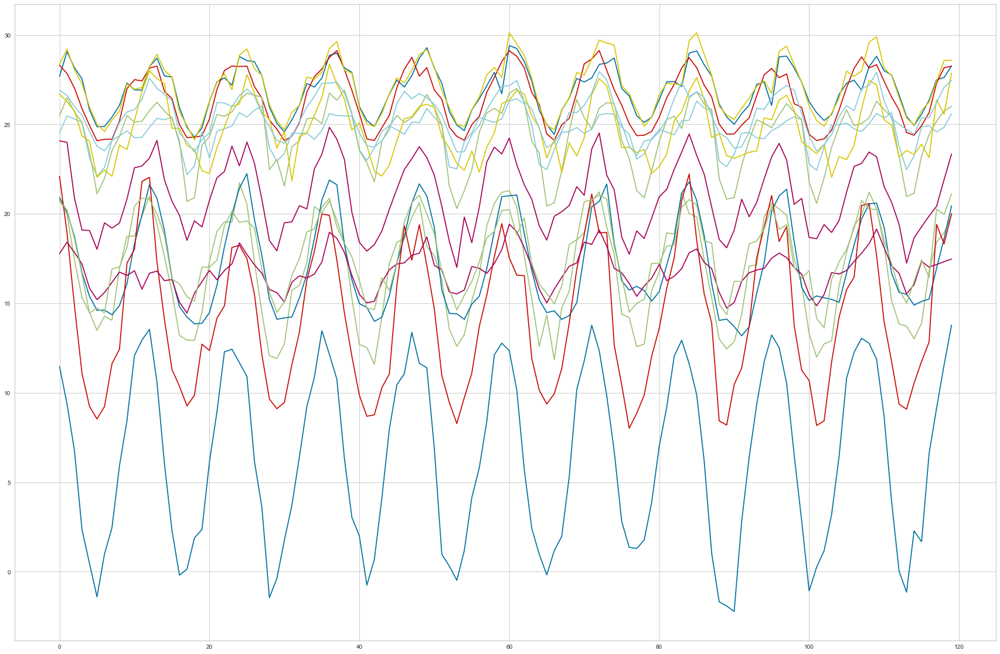

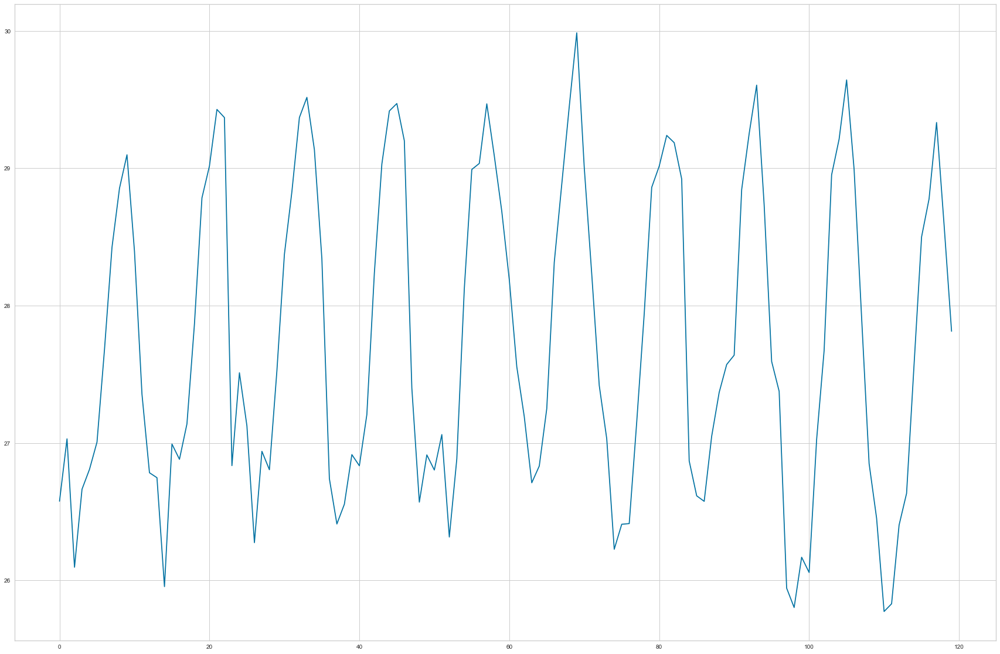

In [36]:
plot_array = []
for j in range(len(counts)):
    t_plot=[]
    for i,elem in enumerate(labels):
        if elem == j:
            t_plot.append(time_series_mean[i])

    t_plot = np.array(t_plot)
    plot_array.append(t_plot)
    
for j in range(len(counts)):
    plt.figure(figsize = (30,20))
    for i in range(plot_array[j].shape[0]):
        plt.plot(plot_array[j][i])
    plt.show()

**print clusters of cities**

In [37]:
cities = []
for j in range(len(counts)):
    city_cluster=[]
    for i,elem in enumerate(labels):
        if elem == j+1:
            city_cluster.append(ts.index[i])

    city_cluster = np.array(city_cluster)
    cities.append(city_cluster)
    
for j in range(len(counts)):
    print("Cluster ", j+1, " : ",end=" ")
    print(cities[j],end="\n\n")

Cluster  1  :  ['Bogotá' 'Cali']

Cluster  2  :  ['Aleppo' 'Alexandria' 'Ankara' 'Baghdad' 'Berlin' 'Cairo' 'Calcutta'
 'Casablanca' 'Changchun' 'Chengdu' 'Chicago' 'Chongqing' 'Dalian' 'Delhi'
 'Dhaka' 'Faisalabad' 'Gizeh' 'Guangzhou' 'Harbin' 'Istanbul' 'Izmir'
 'Jaipur' 'Jiddah' 'Jinan' 'Kabul' 'Kanpur' 'Karachi' 'Kiev' 'Lahore'
 'Lakhnau' 'London' 'Los Angeles' 'Madras' 'Madrid' 'Mashhad' 'Mexico'
 'Montreal' 'Moscow' 'Nagoya' 'Nanjing' 'New Delhi' 'New York' 'Paris'
 'Peking' 'Riyadh' 'Rome' 'Saint Petersburg' 'Santo Domingo' 'Seoul'
 'Shanghai' 'Shenyang' 'Taipei' 'Taiyuan' 'Tangshan' 'Tianjin' 'Tokyo'
 'Toronto' 'Umm Durman' 'Wuhan' 'Xian']

Cluster  3  :  ['Dakar']

Cluster  4  :  ['Ahmadabad' 'Bangalore' 'Bangkok' 'Ho Chi Minh City' 'Hyderabad' 'Kano'
 'Manila' 'Nagpur' 'Pune' 'Rangoon' 'Singapore' 'Surat']

Cluster  5  :  ['Jakarta']

Cluster  6  :  ['Bombay']

Cluster  7  :  ['Addis Abeba' 'Lagos' 'Mogadishu']

Cluster  8  :  ['Belo Horizonte' 'Brasília' 'Harare' 'São Paulo'